In [1]:
import pandas as pd
import polars as pl
import numpy as np
import os
import gc
import seaborn as sns
from tqdm import tqdm
from sklearn.model_selection import KFold, StratifiedKFold
import xgboost as xgb
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor, log_evaluation
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
#from sklearn.impute import IterativeImputer
import pickle
import optuna
import shap

gc.enable()

pd.options.display.max_columns = None
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_colwidth', None)

pl.Config.set_tbl_rows(-1)
pl.Config.set_tbl_cols(-1)
pl.Config.set_fmt_str_lengths(500)

polars.config.Config

In [2]:
path = 'I:/Kaggle/jane-street-real-time-market-data-forecasting/'

In [3]:
os.listdir(path)

['features.csv',
 'kaggle_evaluation',
 'lags.parquet',
 'my_folder',
 'responders.csv',
 'sample_submission.csv',
 'test.parquet',
 'train.parquet']

In [4]:
train_df = pl.read_parquet(path + 'train.parquet/').select(pl.all().shrink_dtype())
y_sr = train_df['responder_6']
train_df = train_df.drop(['responder_0', 'responder_1', 'responder_2', 'responder_3', 'responder_4', 'responder_5', 'responder_6', 'responder_7', 'responder_8', 'partition_id']).select(pl.all().shrink_dtype()).to_pandas()
print(train_df.shape)
train_df.head()

(47127338, 83)


,date_id,time_id,symbol_id,weight,feature_00,feature_01,feature_02,feature_03,feature_04,feature_05,feature_06,feature_07,feature_08,feature_09,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,feature_33,feature_34,feature_35,feature_36,feature_37,feature_38,feature_39,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49,feature_50,feature_51,feature_52,feature_53,feature_54,feature_55,feature_56,feature_57,feature_58,feature_59,feature_60,feature_61,feature_62,feature_63,feature_64,feature_65,feature_66,feature_67,feature_68,feature_69,feature_70,feature_71,feature_72,feature_73,feature_74,feature_75,feature_76,feature_77,feature_78
0,0,0,1,3.889038,NaN,NaN,NaN,NaN,NaN,0.851033,0.242971,0.263400,-0.891687,11,7,76,-0.883028,0.003067,-0.744703,NaN,-0.169586,NaN,-1.335938,-1.707803,0.910130,NaN,1.636431,1.522133,-1.551398,-0.229627,NaN,NaN,1.378301,-0.283712,0.123196,NaN,NaN,NaN,0.281180,0.269163,0.349028,-0.012596,-0.225932,NaN,-1.073602,NaN,NaN,-0.181716,NaN,NaN,NaN,0.564021,2.088506,0.832022,NaN,0.204797,NaN,NaN,-0.808103,NaN,-2.037683,0.727661,NaN,-0.989118,-0.345213,-1.36224,NaN,NaN,NaN,NaN,NaN,-1.251104,-0.110252,-0.491157,-1.022690,0.152241,-0.659864,NaN,NaN,-0.261412,-0.211486,-0.335556,-0.281498
1,0,0,7,1.370613,NaN,NaN,NaN,NaN,NaN,0.676961,0.151984,0.192465,-0.521729,11,7,76,-0.865307,-0.225629,-0.582163,NaN,0.317467,NaN,-1.250016,-1.682929,1.412757,NaN,0.520378,0.744132,-0.788658,0.641776,NaN,NaN,0.227200,0.580907,1.128879,NaN,NaN,NaN,-1.512286,-1.414357,-1.823322,-0.082763,-0.184119,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-10.835207,-0.002704,-0.621836,NaN,1.172836,NaN,NaN,-1.625862,NaN,-1.410017,1.063013,NaN,0.888355,0.467994,-1.36224,NaN,NaN,NaN,NaN,NaN,-1.065759,0.013322,-0.592855,-1.052685,-0.393726,-0.741603,NaN,NaN,-0.281207,-0.182894,-0.245565,-0.302441
2,0,0,9,2.285698,NaN,NaN,NaN,NaN,NaN,1.056285,0.187227,0.249901,-0.773050,11,7,76,-0.675719,-0.199404,-0.586798,NaN,-0.814909,NaN,-1.296782,-2.040234,0.639589,NaN,1.597359,0.657514,-1.350148,0.364215,NaN,NaN,-0.017751,-0.317361,-0.122379,NaN,NaN,NaN,-0.320921,-0.958090,-2.436589,0.070999,-0.245239,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.420632,-3.515137,-4.677760,NaN,0.535897,NaN,NaN,-0.725420,NaN,-2.294170,1.764551,NaN,-0.120789,-0.063458,-1.36224,NaN,NaN,NaN,NaN,NaN,-0.882604,-0.072482,-0.617934,-0.863230,-0.241892,-0.709919,NaN,NaN,0.377131,0.300724,-0.106842,-0.096792
3,0,0,10,0.690606,NaN,NaN,NaN,NaN,NaN,1.139366,0.273328,0.306549,-1.262223,42,5,150,-0.694008,3.004091,0.114809,NaN,-0.251882,NaN,-1.902009,-0.979447,0.241165,NaN,-0.392359,-0.224699,-2.129397,-0.855287,NaN,NaN,0.404142,-0.578156,0.105702,NaN,NaN,NaN,0.544138,-0.087091,-1.500147,-0.201288,-0.038042,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.382074,2.669135,0.611711,NaN,2.413415,NaN,NaN,1.313203,NaN,-0.810125,2.939022,NaN,3.988801,1.834661,-1.36224,NaN,NaN,NaN,NaN,NaN,-0.697595,1.074309,-0.206929,-0.530602,4.765215,0.571554,NaN,NaN,-0.226891,-0.251412,-0.215522,-0.296244
4,0,0,14,0.440570,NaN,NaN,NaN,NaN,NaN,0.955200,0.262404,0.344457,-0.613813,44,3,16,-0.947351,-0.030018,-0.502379,NaN,0.646086,NaN,-1.844685,-1.586560,-0.182024,NaN,-0.969949,-0.673813,-1.282132,-1.399894,NaN,NaN,0.043815,-0.320225,-0.031713,NaN,NaN,NaN,-0.088420,-0.995003,-2.635336,-0.196461,-0.618719,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-2.014600,-2.321076,-3.711265,NaN,1.253902,NaN,NaN,0.476195,NaN,-0.771732,2.843421,NaN,1.379815,0.411827,-1.36224,NaN,NaN,NaN,NaN,NaN,-0.948601,-0.136814,-0.447704,-1.141761,0.099631,-0.661928,NaN,NaN,3.678076,2.793581,2.618250,3.418133


In [5]:
#train_df.estimated_size() / 1e9

In [6]:
sample_df = train_df.sample(frac=0.01)
print(sample_df.shape)
sample_df.head()

(471273, 83)


,date_id,time_id,symbol_id,weight,feature_00,feature_01,feature_02,feature_03,feature_04,feature_05,feature_06,feature_07,feature_08,feature_09,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,feature_33,feature_34,feature_35,feature_36,feature_37,feature_38,feature_39,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49,feature_50,feature_51,feature_52,feature_53,feature_54,feature_55,feature_56,feature_57,feature_58,feature_59,feature_60,feature_61,feature_62,feature_63,feature_64,feature_65,feature_66,feature_67,feature_68,feature_69,feature_70,feature_71,feature_72,feature_73,feature_74,feature_75,feature_76,feature_77,feature_78
22724490,1036,119,22,1.249552,-1.368647,1.483335,-1.162399,-1.059905,-0.911801,0.205665,-0.277012,-0.435530,-0.483975,30,10,13,-0.540144,-0.453397,-0.782075,-0.593641,-0.830169,-0.525891,-0.520188,-2.048980,0.322692,-0.107604,-0.452940,-0.208538,0.381848,0.049451,0.296918,-0.346438,-0.454380,-0.395115,-0.673391,-0.076636,0.269083,1.314683,0.166562,-0.256607,-0.000698,0.379963,-0.263617,-1.218552,-1.101805,-1.785443,-0.930725,-1.150321,-0.030810,-0.331777,0.721878,0.137613,-0.251374,-0.302536,-1.934360,-0.559708,-1.871369,-0.638067,-0.441423,0.051568,-0.671962,0.360328,-0.109798,-0.509796,-0.454482,0.108462,-0.300043,-0.243964,-0.386941,-0.429466,-1.583606,-0.547847,-0.274520,-0.533536,-0.346225,-0.381721,-0.403127,0.435740,0.570959,1.011001,0.817708,0.252461,0.305329
16377715,835,419,11,0.856564,-2.901845,-0.466647,-2.472983,-2.778626,1.419285,-0.404943,-0.459719,-0.451698,-0.386831,46,3,261,-0.484807,0.201879,-0.177025,0.137091,0.681244,0.158695,-0.417852,1.498303,-0.126155,-0.223121,-1.272689,0.317061,-0.223647,-1.024787,-1.065972,0.243033,0.481134,0.144709,0.105928,-0.272706,-2.212752,-0.225083,-2.106078,-2.308171,-0.838566,0.031398,-0.275515,-1.479072,-0.383559,-0.375784,0.383313,0.061122,-0.733353,-0.306347,1.197710,-0.179330,-0.813968,-0.623675,-0.449470,1.646883,0.005278,0.134816,0.390041,-0.776634,-0.236179,1.125079,-0.107935,-0.485915,-0.384867,1.738144,-0.109069,-0.184691,-0.095684,0.373777,1.259344,-0.707747,0.025502,-0.175759,-0.508852,0.244316,-0.087831,-0.163638,-0.137630,-0.236533,-0.284906,0.044950,0.076660
12461726,703,548,0,2.191205,0.527565,0.376976,0.711714,0.689882,0.114538,0.045993,-0.077896,0.050563,-1.092724,11,7,76,-0.554009,-0.494506,-0.686731,-0.256318,0.043132,-0.205645,0.200540,0.079177,0.722064,-0.236016,1.369042,0.776624,-0.150804,0.015869,1.141274,1.310844,1.300523,-0.248930,-0.267217,-0.229353,-0.576323,-0.393993,-0.523751,-0.347409,-0.077443,-0.160128,-0.839604,-0.107695,-1.286316,-1.366254,0.164364,-0.515982,-0.472838,0.517328,-1.106799,-0.247718,0.040652,-0.032365,0.071500,-0.698900,-0.294730,0.235641,-0.145358,1.833928,0.374518,-0.070597,-0.325561,0.041537,-0.017495,0.038629,-0.255747,-0.537744,-0.249134,-0.177257,0.093063,-0.429915,-0.335981,-0.513170,-0.766049,-0.363057,-0.823024,-0.362232,-0.174425,-0.356480,-0.106533,-0.233566,-0.214155
8906185,557,269,17,1.891409,1.378695,0.243488,0.892909,0.891052,0.612806,-0.309383,-0.351238,-0.981665,0.612281,64,6,376,-0.593997,-0.312497,-0.686726,-0.346451,-0.557786,-0.487995,-0.994372,1.079484,-0.967110,-0.197450,-0.725186,-1.142649,-0.163547,-0.896096,0.279394,0.651846,1.005889,-0.749430,-0.580632,-0.349213,2.193071,0.089840,2.240690,2.013453,-1.465261,-0.519014,-0.020451,1.150439,-0.946715,-1.534434,-0.030909,-1.372154,0.271114,0.189124,0.751202,0.424362,0.074974,-0.069497,0.728070,-0.619638,-0.289549,0.151504,0.572558,1.800601,0.608810,1.021642,0.769103,-0.180269,0.050495,-1.007222,0.094809,-0.329693,-0.087376,-1.275604,0.348948,-0.463681,-0.382373,-0.599593,-0.489558,-0.506169,-0.491002,-0.506413,-0.468411,-0.116211,-0.111905,-0.539439,-0.489274
11584087,671

In [7]:
sample_y_sr = y_sr.to_pandas().loc[sample_df.index]
print(sample_y_sr.shape)
sample_y_sr.head()

(471273,)


22724490   -0.320489
16377715    0.059907
12461726   -1.035688
8906185    -0.327871
11584087    0.133846
Name: responder_6, dtype: float32

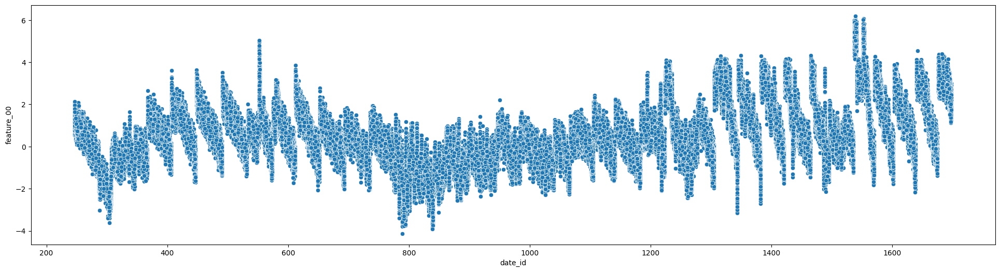

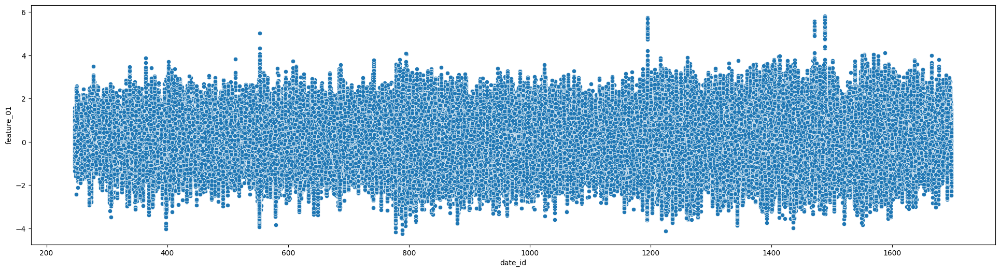

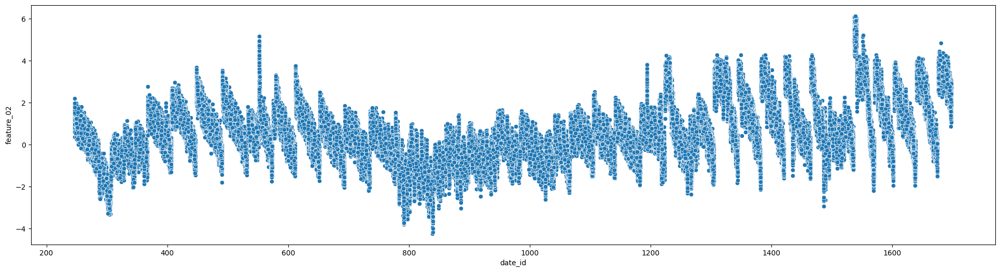

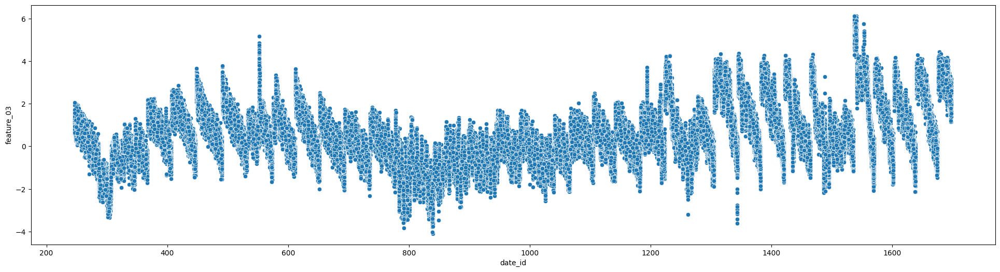

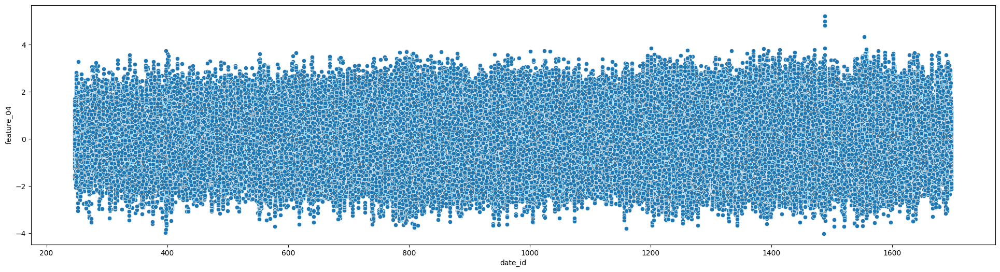

...

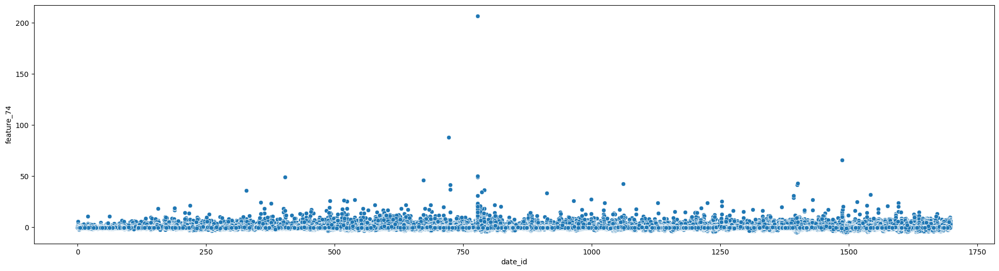

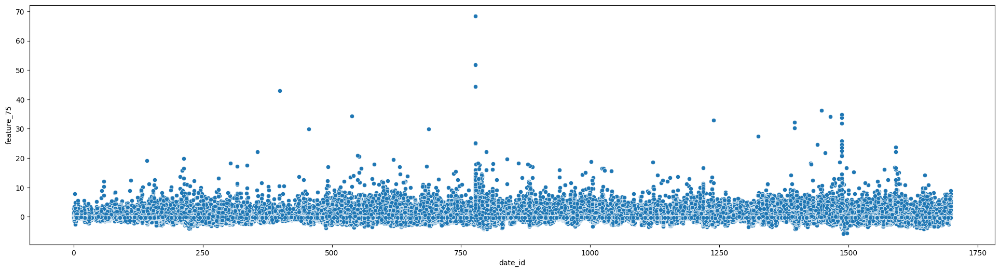

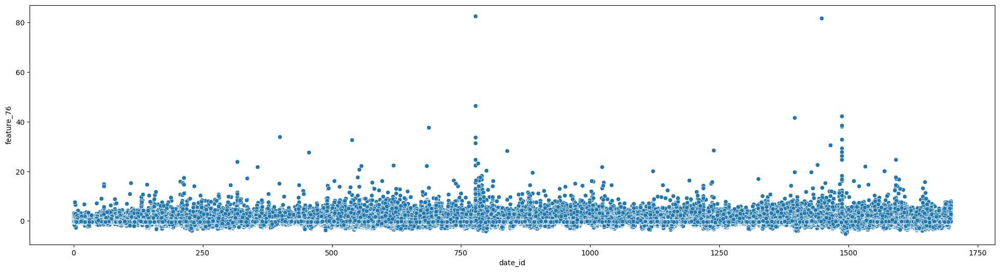

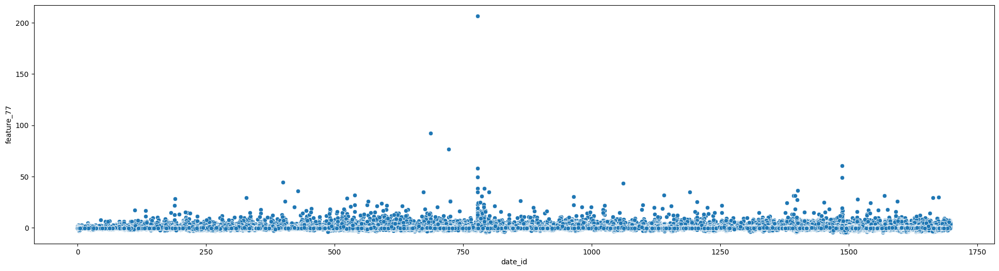

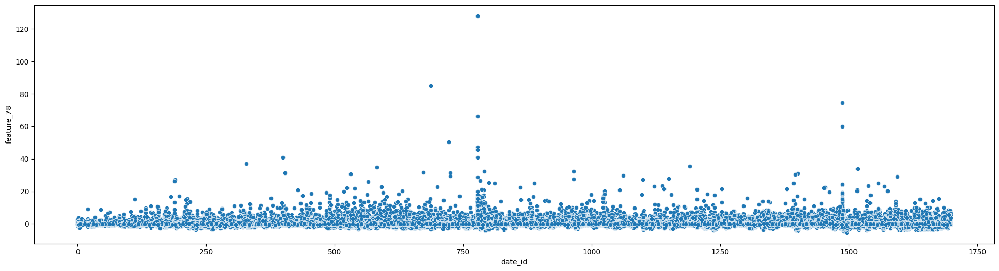

In [9]:
for col in sample_df.columns:
    if 'feature' in col:
        plt.figure(figsize=(24, 6))
        sns.scatterplot(x=sample_df['date_id'], y=sample_df[col])
        plt.show()

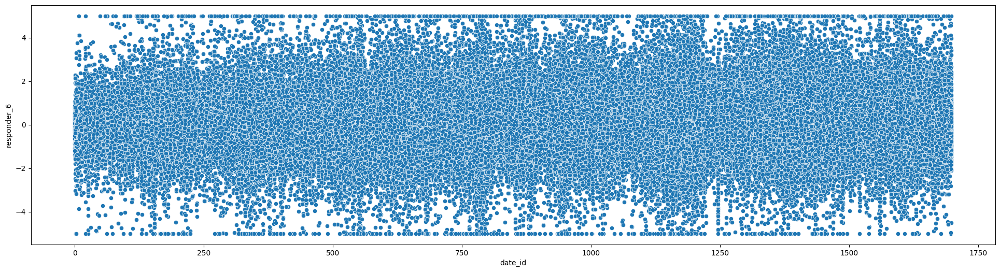

In [9]:
plt.figure(figsize=(24, 6))
sns.scatterplot(x=sample_df['date_id'], y=sample_y_sr)
plt.show()

In [ ]:
def lgb_train(train_data, y):
    weights = train_data['weight']
    
    unique_date_ids = train_data['date_id'].unique()
    train_date_id_cut = int(unique_date_ids.max() - 10)

    print('max date:', unique_date_ids.max())
    print('date id cut:', train_date_id_cut)
    
    X_train = train_data.filter(pl.col('date_id') <= train_date_id_cut).drop(['date_id', 'time_id', 'symbol_id', 'weight']).select(pl.all().shrink_dtype()).to_pandas()
    X_val = train_data.filter(pl.col('date_id') > train_date_id_cut).drop(['date_id', 'time_id', 'symbol_id', 'weight']).select(pl.all().shrink_dtype()).to_pandas()

    print(X_train.shape[0] / train_data.shape[0])
    
    y_train = y[:X_train.shape[0]].to_pandas()
    y_val = y[X_train.shape[0]:].to_pandas()
    
    weights_train = weights[:X_train.shape[0]].to_pandas()
    weights_val = weights[X_train.shape[0]:].to_pandas()

    print(X_train.shape)
    display(X_train.head())

    base_params = {
        'verbosity': -1,
        'learning_rate': 0.03,
        'feature_fraction': 0.8,
        'device': 'gpu',
        'early_stopping_round': 30,
        'lambda_l2': 100
    }
    
    model = LGBMRegressor(
        **base_params,
        n_estimators=100000
    )

    model.fit(X_train, y_train, sample_weight=weights_train, eval_set=[(X_train, y_train), (X_val, y_val)], eval_sample_weight=[weights_train, weights_val], callbacks=[log_evaluation(period=50)])#, categorical_feature=['feature_09', 'feature_10', 'feature_11'])

    val_preds = model.predict(X_val)

    plt.figure()
    lgb.plot_metric(model)
    plt.ylim(0, 1)
    plt.show()

    models_path = path + 'my_folder/models/20241229_06/'

    if not os.path.exists(models_path):
        os.makedirs(models_path)

    with open(models_path + "lgb_model.pkl", 'wb') as file:
        pickle.dump(model, file)

    print('Val R2 score is:', r2_score(y_val, val_preds))
    print('Val Weighted R2 score is:', r2_score(y_val, val_preds, sample_weight=weights_val))

    sample_val = X_val.sample(frac=0.001)
    sample_y = y_val.loc[sample_val.index]

    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X=sample_val, y=sample_y)
    shap_importance = np.abs(shap_values).mean(axis=0)

    return shap_importance

In [ ]:
first_shap_importance = lgb_train(train_df, y_sr)

In [ ]:
cols = train_df.drop(['date_id', 'time_id', 'symbol_id']).columns
imp_df = pd.DataFrame(sorted(zip(cols, first_shap_importance)), columns=['Feature', 'Importance']).sort_values('Importance', ascending=False)

In [ ]:
print(imp_df.shape)

In [ ]:
imp_df

In [ ]:
plt.figure(figsize=(10, 40))
plt.title("Feature importances")
plt.barh(imp_df['Feature'], imp_df['Importance'])
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.gca().invert_yaxis()
plt.show()

In [ ]:
unimportant_df = imp_df[imp_df['Importance'] <= imp_df['Importance'].quantile(0.3)]
unimportant_cols = unimportant_df['Feature'].tolist()

In [ ]:
train_selected_df = train_df.drop(unimportant_cols)
print(train_selected_df.shape)
train_selected_df.head()

In [ ]:
second_shap_importance = lgb_train(train_selected_df, y_sr)